# House price prediction - EDA

[Source](https://github.com/harlfoxem/House_Price_Prediction)

In [10]:
import numpy as np 
import pandas as pd 
pd.set_option('display.max_columns', None) 

import matplotlib.pyplot as plt 
%matplotlib inline 

import seaborn as sns 
sns.set_style('whitegrid') 

import warnings
warnings.filterwarnings('ignore') 

from scipy import stats, linalg

import folium 
from folium import plugins

## Load data

In [11]:
data = pd.read_csv("data/kc_house_data.csv.zip", parse_dates = ['date'])

data['waterfront'] = data['waterfront'].astype('category',ordered=True)
data['view'] = data['view'].astype('category',ordered=True)
data['condition'] = data['condition'].astype('category',ordered=True)
data['grade'] = data['grade'].astype('category',ordered=False)
data['zipcode'] = data['zipcode'].astype(str)
data = data.sort_values('date')

data.head(2) # Show the first 2 lines

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
16768,5561000190,2014-05-02,437500.0,3,2.25,1970,35100,2.0,0,0,4,9,1970,0,1977,0,98027,47.4635,-121.991,2340,35100
9596,472000620,2014-05-02,790000.0,3,2.50,2600,4750,1.0,0,0,4,9,1700,900,1951,0,98117,47.6833,-122.400,2380,4750


In [12]:
data.dtypes

id                        int64
date             datetime64[ns]
price                   float64
bedrooms                  int64
bathrooms               float64
sqft_living               int64
sqft_lot                  int64
floors                  float64
waterfront             category
view                   category
condition              category
grade                  category
sqft_above                int64
sqft_basement             int64
yr_built                  int64
yr_renovated              int64
zipcode                  object
lat                     float64
long                    float64
sqft_living15             int64
sqft_lot15                int64
dtype: object

## Descriptive statistics

In [13]:
data.shape

(21613, 21)

In [14]:
data.describe(include='all')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,21613,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.0,21613.0,21613.0,21613.0,21613.000000,21613.000000,21613.000000,21613.000000,21613,21613.000000,21613.000000,21613.000000,21613.000000
unique,NaN,372,NaN,NaN,NaN,NaN,NaN,NaN,2.0,5.0,5.0,12.0,NaN,NaN,NaN,NaN,70,NaN,NaN,NaN,NaN
top,NaN,2014-06-23 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,3.0,7.0,NaN,NaN,NaN,NaN,98103,NaN,NaN,NaN,NaN
freq,NaN,142,NaN,NaN,NaN,NaN,NaN,NaN,21450.0,19489.0,14031.0,8981.0,NaN,NaN,NaN,NaN,602,NaN,NaN,NaN,NaN
first,NaN,2014-05-02 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2015-05-27 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,4.580302e+09,NaN,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,NaN,NaN,NaN,NaN,1788.390691,291.509045,1971.005136,84.402258,NaN,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,NaN,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,NaN,NaN,NaN,NaN,828.090978,442.575043,29.373411,401.679240,NaN,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,NaN,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,NaN,NaN,NaN,NaN,290.000000,0.000000,1900.000000,0.000000,NaN,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,NaN,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,NaN,NaN,NaN,NaN,1190.000000,0.000000,1951.000000,0.000000,NaN,47.471000,-122.328000,1490.000000,5100.000000


## Interactive map
The map is helpful but it's hard to see where the houses in our dataset are 

In [20]:
from folium.plugins import MarkerCluster

houses_map = folium.Map(location = [data['lat'].mean(), data['long'].mean()], zoom_start = 10)
marker_cluster = MarkerCluster().add_to(houses_map)
MAX_RECORDS = 100
for name, row in data.iterrows():
    folium.Marker([row["lat"], row["long"]], 
                  popup="Sold for {0}$ on: {1}. Features: {2} sqft, {3} bedrooms, {4} bathrooms, year built: {5}"\
                  .format(row["price"], row["date"], row['sqft_living'], 
                          row['bedrooms'], row['bathrooms'], row['yr_built'])).add_to(marker_cluster)
    
houses_map

**Heatmap**

Heatmaps are good for mapping out gradients, but we’ll want something with more structure to plot out differences in house sale accross the county. Zip codes are a good way to visualize this information.

In [19]:
houses_heatmap = folium.Map(location = [data['lat'].mean(), data['long'].mean()], zoom_start = 9)
houses_heatmap.add_children(plugins.HeatMap([[row["lat"], row["long"]] for name, row in data.iterrows()]))

houses_heatmap

We could compute the mean house price by zip code, then plot this out on a map

In [21]:
zipcode_data = data.groupby('zipcode').aggregate(np.mean)
zipcode_data.reset_index(inplace=True)

data['count'] = 1
count_houses_zipcode = data.groupby('zipcode').sum()
count_houses_zipcode.reset_index(inplace=True)
count_houses_zipcode = count_houses_zipcode[['zipcode','count']]
data.drop(['count'], axis = 1, inplace = True)

zipcode_data = pd.merge(zipcode_data, count_houses_zipcode, how='left', on=['zipcode'])
zipcode_data.head(2)

,zipcode,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,count
0,98001,4.664787e+09,280804.690608,3.383978,2.006215,1900.856354,14937.450276,1.429558,1721.325967,179.530387,1980.679558,43.801105,47.30902,-122.270646,1828.856354,11214.403315,362
1,98002,4.850894e+09,234284.035176,3.326633,1.839196,1627.743719,7517.633166,1.334171,1522.537688,105.206030,1967.773869,59.889447,47.30878,-122.213357,1479.030151,7585.482412,199


We’ll now be able to plot the average value of a specific attribute for each zip code. In order to do this, we’ll read data in GeoJSON format to get the shape of each zip code, then match each zip code shape with the attribute score

In [44]:
def show_zipcode_map(col):
    geo_path = 'data/zipcode_king_county.geojson'
    zipcode = folium.Map(location=[data['lat'].mean(), data['long'].mean()], zoom_start=8)
    zipcode.choropleth(geo_data = geo_path,
                       name = 'choropleth',
                       data=zipcode_data, 
                       columns = ['zipcode', col], 
                       key_on = 'feature.properties.ZCTA5CE10',
                       fill_color='BuPu', 
                       fill_opacity=0.7,
                       line_opacity=0.2,
                      legend_name = col)
    return zipcode

In [45]:
show_zipcode_map('count')

In [47]:
show_zipcode_map('price')

In [49]:
show_zipcode_map('sqft_living')

In [50]:
show_zipcode_map('yr_built')

### Output variable

Let's first display the distribution of the target column (`price`) using a boxplot

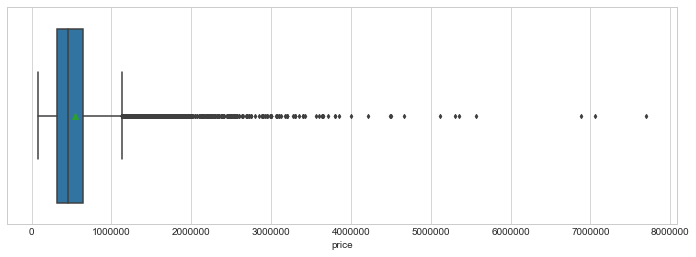

In [51]:
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(x = 'price', data = data, orient = 'h', width = 0.8, 
                 fliersize = 3, showmeans=True, ax = ax)
plt.show()

## Associations and Correlations between Variables

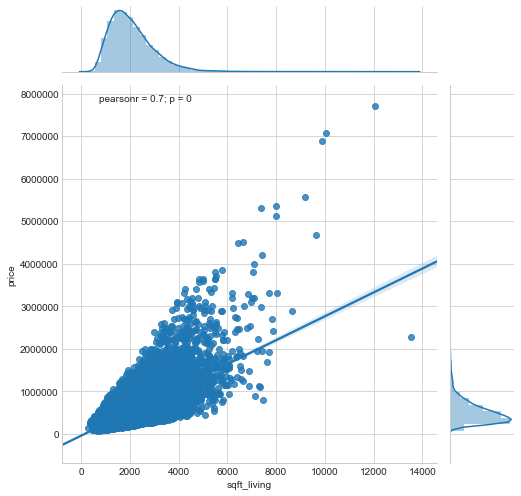

In [78]:
sns.jointplot(x="sqft_living", y="price", data=data, kind = 'reg', size = 7)
plt.show()

In [79]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;
//First, a simple command to increase the maximum size of the output cells in the notebook

<IPython.core.display.Javascript object>

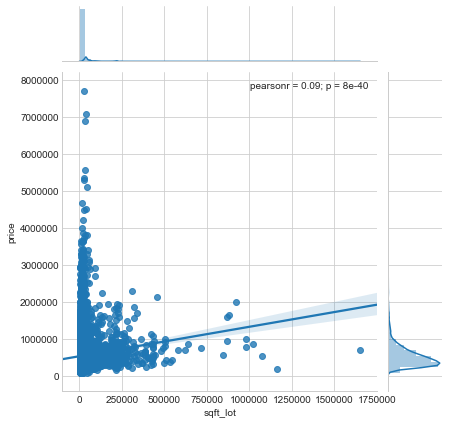

In [56]:
sns.jointplot(x="sqft_lot", y="price", data=data, kind = 'reg');

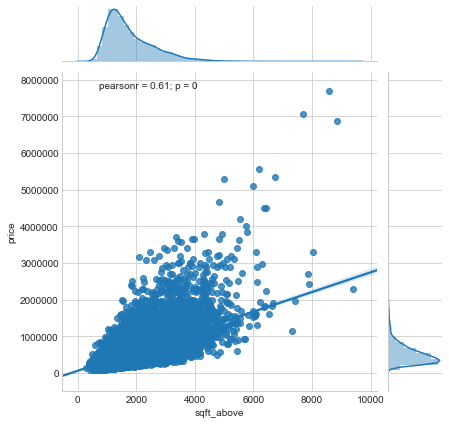

In [57]:
sns.jointplot(x="sqft_above", y="price", data=data, kind = 'reg');

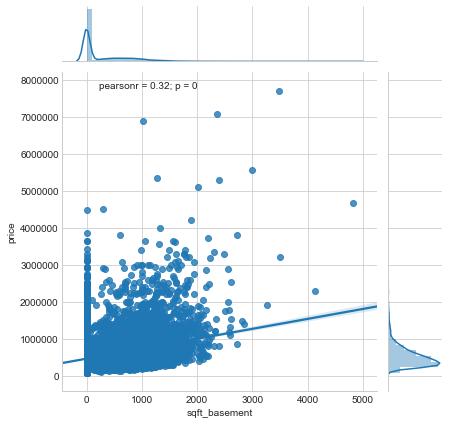

In [58]:
sns.jointplot(x="sqft_basement", y="price", data=data, kind = 'reg');

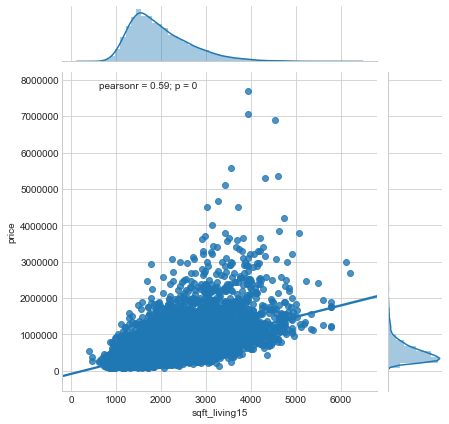

In [59]:
sns.jointplot(x="sqft_living15", y="price", data=data, kind = 'reg');

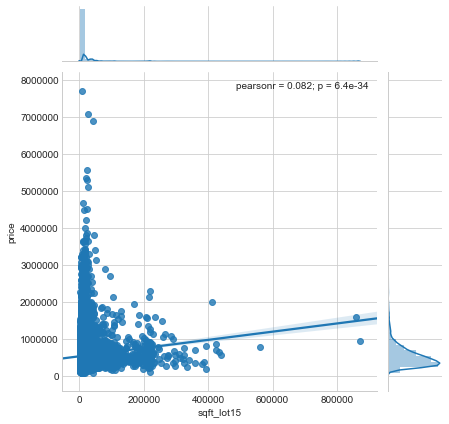

In [60]:
sns.jointplot(x="sqft_lot15", y="price", data=data, kind = 'reg');

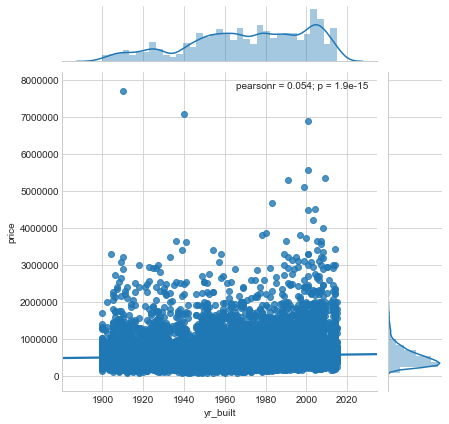

In [61]:
sns.jointplot(x="yr_built", y="price", data=data, kind = 'reg');

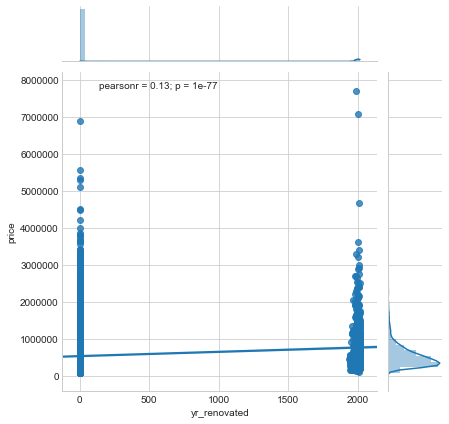

In [62]:
sns.jointplot(x="yr_renovated", y="price", data=data, kind = 'reg');

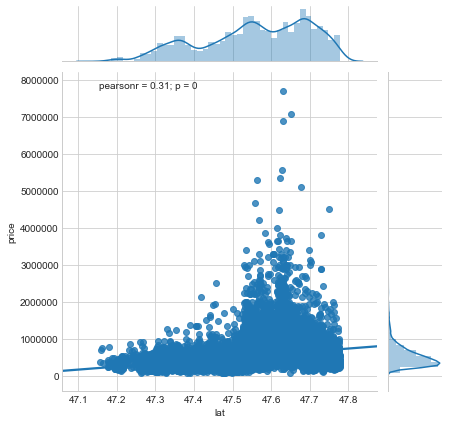

In [63]:
sns.jointplot(x="lat", y="price", data=data, kind = 'reg');

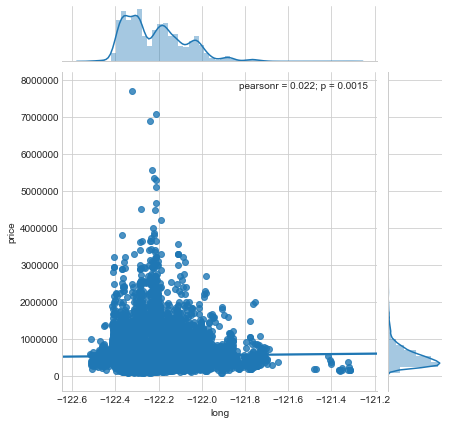

In [64]:
sns.jointplot(x="long", y="price", data=data, kind = 'reg');

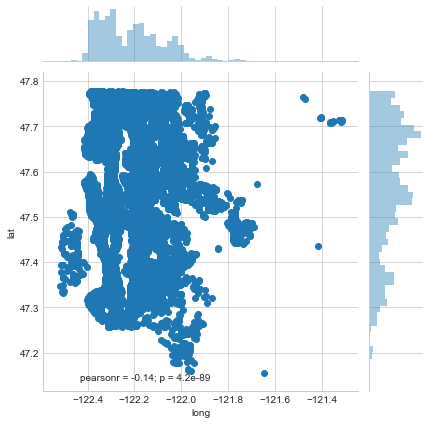

In [66]:
sns.jointplot(x="long", y="lat", data=data);

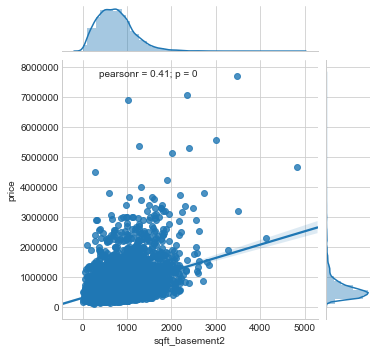

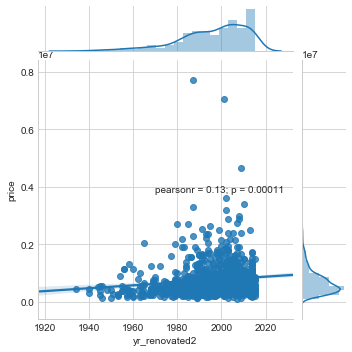

In [67]:
# Create 2 new columns for the analysis 
data['sqft_basement2'] = data['sqft_basement'].apply(lambda x: x if x > 0 else None)
data['yr_renovated2'] = data['yr_renovated'].apply(lambda x: x if x > 0 else None)

# Show the new plots with pearson correlation
sns.jointplot(x="sqft_basement2", y="price", data=data, kind = 'reg', dropna=True, size = 5)
sns.jointplot(x="yr_renovated2", y="price", data=data, kind = 'reg', dropna=True, size = 5)
plt.show()

In [68]:
data['basement_present'] = data['sqft_basement'].apply(lambda x: 1 if x > 0 else 0)
data['basement_present'] = data['basement_present'].astype('category', ordered = False)

data['renovated'] = data['yr_renovated'].apply(lambda x: 1 if x > 0 else 0)
data['renovated'] = data['renovated'].astype('category', ordered = False)

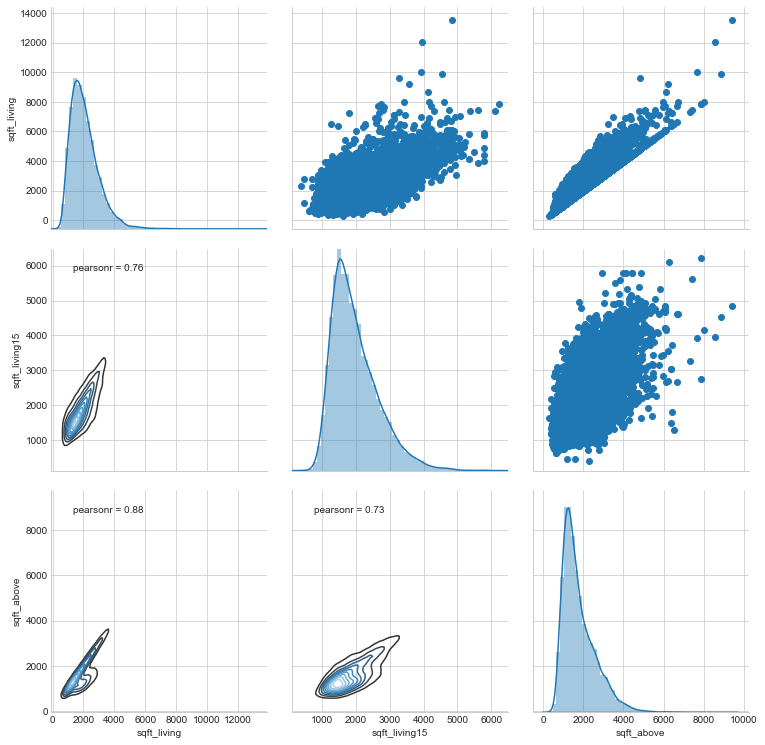

In [69]:
# define a function to display pearson coefficients on the lower graphs 
def corrfunc(x, y, **kws):
    r, _ = stats.pearsonr(x, y)
    ax = plt.gca()
    ax.annotate("pearsonr = {:.2f}".format(r),
                xy=(.1, .9), xycoords=ax.transAxes)

g = sns.PairGrid(data, vars = ['sqft_living', 'sqft_living15', 'sqft_above'], size = 3.5) # define the pairgrid
g.map_upper(plt.scatter) 
g.map_diag(sns.distplot)
g.map_lower(sns.kdeplot, cmap="Blues_d")
g.map_lower(corrfunc)
plt.show()

In [70]:
# a Function to returns the sample linear partial correlation coefficients between pairs of variables in C, controlling 
# for the remaining variables in C (clone of Matlab's partialcorr). 
def partial_corr(C):
    C = np.asarray(C)
    p = C.shape[1]
    P_corr = np.zeros((p, p), dtype=np.float)
    for i in range(p):
        P_corr[i, i] = 1
        for j in range(i+1, p):
            idx = np.ones(p, dtype=np.bool)
            idx[i] = False
            idx[j] = False
            beta_i = linalg.lstsq(C[:, idx], C[:, j])[0]
            beta_j = linalg.lstsq(C[:, idx], C[:, i])[0]
            res_j = C[:, j] - C[:, idx].dot( beta_i)
            res_i = C[:, i] - C[:, idx].dot(beta_j)            
            corr = stats.pearsonr(res_i, res_j)[0]
            P_corr[i, j] = corr
            P_corr[j, i] = corr
    return P_corr

# Convert pandas dataframe to a numpy array using only three columns
partial_corr_array = data.as_matrix(columns = ['price', 'sqft_living', 'sqft_living15'])

# Calculate the partial correlation coefficients
partial_corr(partial_corr_array)

array([[1.        , 0.48387837, 0.06254496],
       [0.48387837, 1.        , 0.7792972 ],
       [0.06254496, 0.7792972 , 1.        ]])

### Categorical variables

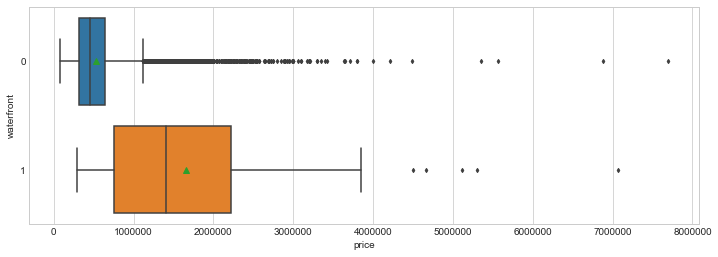

point biserial correlation r is 0.2664 with p = 0.0


In [73]:
# Let's show boxplots first
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(y = 'waterfront', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = ax)
plt.show()

# Calculate the correlation coefficient
r, p = stats.pointbiserialr(data['waterfront'], data['price'])
print ('point biserial correlation r is %s with p = %s' %(r.round(4),p))

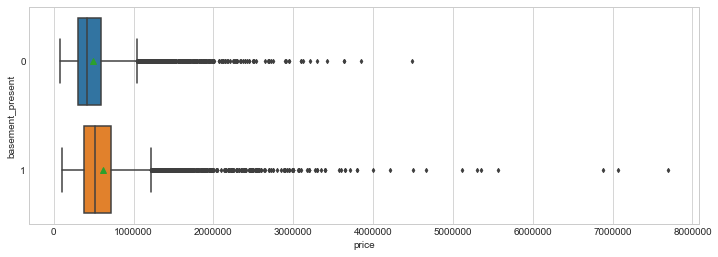

point biserial correlation r between price and basement_present is 0.1802 with p = 3.2567787361972933e-157



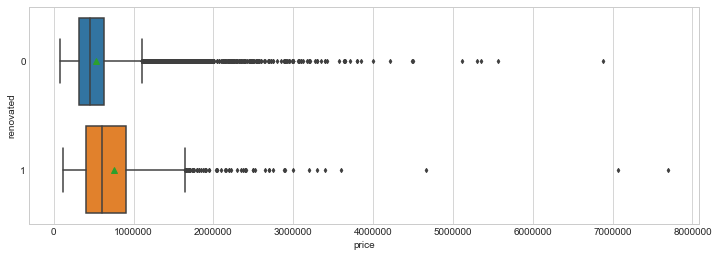

point biserial correlation r between price and renovated is 0.1261 with p = 2.6401485917732445e-77


In [76]:
# basement_present variable
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(y = 'basement_present', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = ax)
plt.show()
r, p = stats.pointbiserialr(data['basement_present'], data['price'])
print ('point biserial correlation r between price and basement_present is %s with p = %s' %(r.round(4),p))

# renovated variable
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(y = 'renovated', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = ax)
print ('')
plt.show()
r, p = stats.pointbiserialr(data['renovated'], data['price'])
print ('point biserial correlation r between price and renovated is %s with p = %s' %(r.round(4),p))

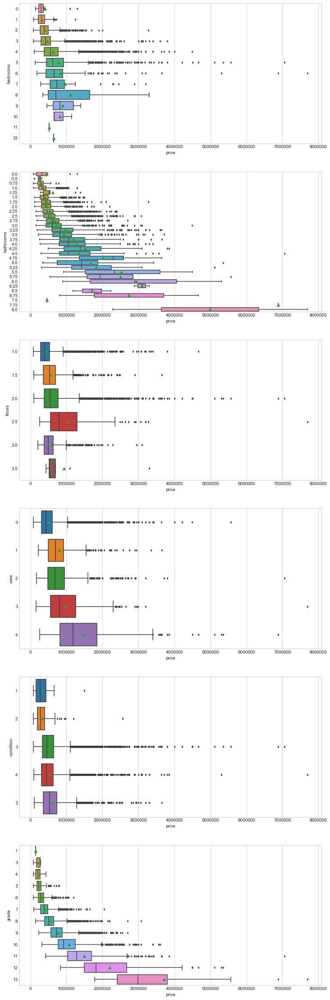

In [77]:
fig, axarr = plt.subplots(6, figsize=(12,40))
sns.boxplot(y = 'bedrooms', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[0])
sns.boxplot(y = 'bathrooms', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[1])
sns.boxplot(y = 'floors', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[2])
sns.boxplot(y = 'view', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[3])
sns.boxplot(y = 'condition', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[4])
sns.boxplot(y = 'grade', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = axarr[5])
plt.show()

In [80]:
r, p = stats.spearmanr(data['bedrooms'], data['price'])
print ('spearman correlation r between price and bedrooms is %s with p = %s' %(r,p))
r, p = stats.spearmanr(data['bathrooms'], data['price'])
print ('spearman correlation r between price and bathrooms is %s with p = %s' %(r,p))
r, p = stats.spearmanr(data['floors'], data['price'])
print ('spearman correlation r between price and floors is %s with p = %s' %(r,p))
r, p = stats.spearmanr(data['view'], data['price'])
print ('spearman correlation r between price and view is %s with p = %s' %(r,p))
r, p = stats.spearmanr(data['condition'], data['price'])
print ('spearman correlation r between price and condition is %s with p = %s' %(r,p))
r, p = stats.spearmanr(data['grade'], data['price'])
print ('spearman correlation r between price and grade is %s with p = %s' %(r,p))

spearman correlation r between price and bedrooms is 0.34465237095978885 with p = 0.0
spearman correlation r between price and bathrooms is 0.49716035081092047 with p = 0.0
spearman correlation r between price and floors is 0.32234655003563695 with p = 0.0
spearman correlation r between price and view is 0.29393116417024306 with p = 0.0
spearman correlation r between price and condition is 0.018489958301262526 with p = 0.006560828406548436
spearman correlation r between price and grade is 0.6582152214259374 with p = 0.0
